# AquaGrade Mask R-CNN Model
> Since the collective members of the group, agreed upon, that a single bounding boxes will not do for our task, ever since the overhaul of their Computer Vision (CV) technique, they changed to masks segmentation or CV enthusiasts says **instance segmentation**.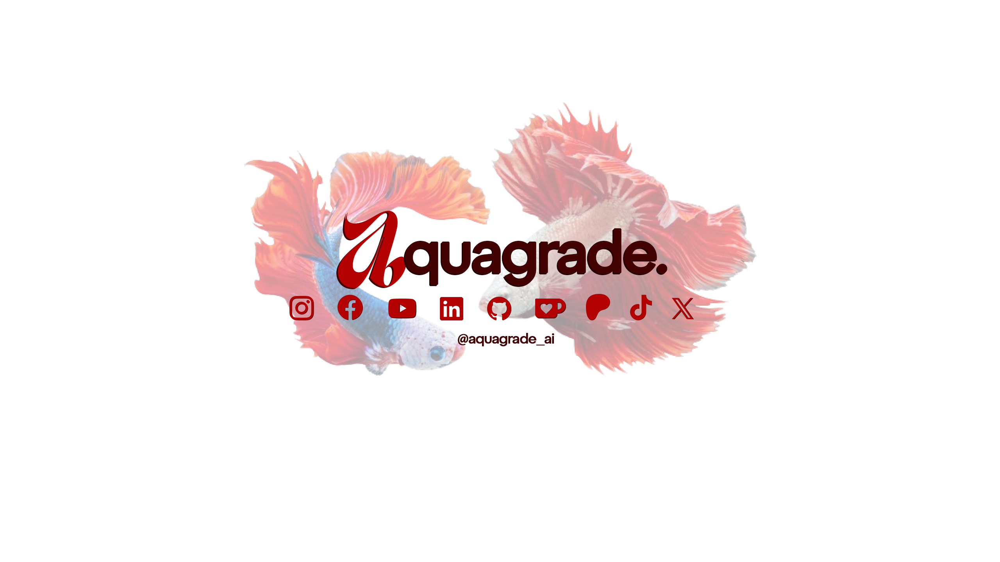

## Setups
> Includes, **paths necessary** for *proper working of directories*, **installing libraries** out of the box, and then **importing the libraries** that have been installed.

### Imports
> _**all of the imports** from useful **external and internal libraries** of Python is here_ **Imports:**
1.   `os`
2.   `json`





In [3]:
# * Import general libraries

# * For pathfinding or navigating the file system
import os
import json
import math
from pathlib import Path
import random
import hashlib
import shutil

# * Import necessary libraries for image processing
import numpy as np
from PIL import Image, ImageDraw
from PIL import ImageOps

# * Imports for plotting
import matplotlib.pyplot as plt
import pandas as pd

from pycocotools.coco import COCO
import matplotlib.patches as patches

# * Imports for GUI libraries
from tqdm import tqdm

# * Imports for documentations
from docx import Document
from docx.shared import Inches

# * Import necessary libraries for model training
import torch
import torchmetrics
import torchvision
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
from torch.optim.lr_scheduler import CosineAnnealingLR
from torch import nn, optim
import torchvision.models as models
import torchvision.transforms.functional as F
from torch.optim.lr_scheduler import ReduceLROnPlateau

# * Import sci-kit cross-validation libraries
from sklearn.model_selection import KFold
from sklearn.metrics import confusion_matrix, precision_recall_fscore_support, precision_recall_curve, ConfusionMatrixDisplay

ModuleNotFoundError: No module named 'numpy'

### Necessary Paths
> All necessary routes are *initialized* here for **better organization of paths**

In [18]:
# * Define paths correctly without the leading '/' in the relative path
PROJECT_PATH = os.path.abspath(os.getcwd())

# * Load config path
CONFIG_PATH = os.path.join(PROJECT_PATH, 'config')

# * Load data path
DATA_PATH = os.path.join(PROJECT_PATH, 'data')

# * Joins aquagrade_pkg/src
SRC_PATH = os.path.join(PROJECT_PATH, 'src')

# * Load the requirements.txt path
REQUIREMENTS_PATH = os.path.join(PROJECT_PATH, 'requirements.txt')

# * Load the dataset path
DATASET_PATH = os.path.join(PROJECT_PATH, 'data', 'annotated', 'dataset')
LABEL_JSON_PATH = os.path.join(CONFIG_PATH, 'label_paths.json')

# * contains routes to train, valid and test images
DATASET_CONFIG_PATH = os.path.join(CONFIG_PATH, 'dataset_paths.json')

# * Data cleaned directories
CLEANED_TRAIN_IMAGES_PATH = os.path.join(DATA_PATH, 'clean', 'train')
CLEANED_VALID_IMAGES_PATH = os.path.join(DATA_PATH, 'clean', 'valid')
CLEANED_TEST_IMAGES_PATH = os.path.join(DATA_PATH, 'clean', 'test')

# * Model saving paths
MODEL_PATH = os.path.join(PROJECT_PATH, "models", "saved")
CHECKPOINT_PATH = os.path.join(MODEL_PATH, "checkpoints")

c:\Users\acer\Downloads\AquaGrade\model_pkg


### Installation of Dependencies/Libraries
> All **dependencies** are **installed via single configuration** file named, `requirements.txt`

In [3]:
# Install the requirements
%pip install -r {REQUIREMENTS_PATH}

Note: you may need to restart the kernel to use updated packages.


ERROR: Could not open requirements file: [Errno 2] No such file or directory: '{REQUIREMENTS_PATH}'
You should consider upgrading via the 'c:\Users\acer\AppData\Local\Programs\Python\Python39-32\python.exe -m pip install --upgrade pip' command.


## Preprocessing Data Pipeline
> This is one of the crucial pipeline, as it handles **the preparation of dataset**, that includes, of course;

1.   Loading and Verification of Dataset Content & Paths,
2.   Data Normalization,
3.   Data Cleaning,
4.   Data Augmentation,
5.   Loading and Verification of Dataset Images & True Labels.

### Loading Data from JSON Formatted File
> *this is a modular function made for the purpose of **reading a json file**, useful for later deeds*

In [7]:
def load_json(json_path):
    """Load data from a COCO-format JSON file."""
    with open(json_path, "r") as f:
        return json.load(f)

### Verification of Dataset Routes/Path
> *this aims to **verify** if the **dataset routes** is **well-routed** within the JSON file config data*

In [8]:
# Read dataset_paths.json
dataset_paths = load_json(DATASET_CONFIG_PATH)

TRAIN_IMAGES_PATH = dataset_paths['train']
VALID_IMAGES_PATH = dataset_paths['valid']
TEST_IMAGES_PATH = dataset_paths['test']

# Verify paths within the subset of dataset
print("Verifying paths:")
print(f"Train path exists: {os.path.exists(TRAIN_IMAGES_PATH)}")
print(f"Validation path exists: {os.path.exists(VALID_IMAGES_PATH)}")
print(f"Test path exists: {os.path.exists(TEST_IMAGES_PATH)}")

# Print full paths for reference
print("\nFull paths:")
print(f"Train: {os.path.abspath(dataset_paths['train'])}")
print(f"Validation: {os.path.abspath(dataset_paths['valid'])}")
print(f"Test: {os.path.abspath(dataset_paths['test'])}")

Verifying paths:
Train path exists: True
Validation path exists: True
Test path exists: True

Full paths:
Train: /content/drive/MyDrive/colab_nb/aquagrade_pkg/data/annotated/dataset/train/images
Validation: /content/drive/MyDrive/colab_nb/aquagrade_pkg/data/annotated/dataset/valid/images
Test: /content/drive/MyDrive/colab_nb/aquagrade_pkg/data/annotated/dataset/test/images


### Visualization of Splitted Unnormalized & Base Dataset

> The code below will **show the distribution of images to 70:10:10** ratio of **train, valid, and test raw images**, that means, it is _not normalized, augmented or cleaned_, as of yet.

In [9]:
# Function to load and resize images
def load_and_resize_image(image_path, target_size=(100, 100)):
    try:
        with Image.open(image_path) as img:
            return img.resize(target_size, Image.LANCZOS)
    except Exception as e:
        print(f"Error loading image {image_path}: {str(e)}")
        return Image.new('RGB', target_size, color='red')

# Function to create image grid
def create_image_grid(images_path, grid_size):
    image_files = [f for f in os.listdir(images_path) if f.lower().endswith(
        ('.png', '.jpg', '.jpeg', '.bmp', '.gif'))]
    grid = np.zeros((grid_size * 100, grid_size * 100, 3), dtype=np.uint8)
    for i, img_file in enumerate(tqdm(image_files[:grid_size*grid_size], desc="Loading images")):
        if i >= grid_size * grid_size:
            break
        row = i // grid_size
        col = i % grid_size
        img_path = os.path.join(images_path, img_file)
        img = load_and_resize_image(img_path)
        grid[row*100:(row+1)*100, col*100:(col+1)*100] = np.array(img)
    return grid, len(image_files)

    # Calculate grid size for all sets
train_grid_size = min(100, math.ceil(
    math.sqrt(len(os.listdir(TRAIN_IMAGES_PATH)))))
valid_grid_size = min(100, math.ceil(
    math.sqrt(len(os.listdir(VALID_IMAGES_PATH)))))
test_grid_size = min(100, math.ceil(
    math.sqrt(len(os.listdir(TEST_IMAGES_PATH)))))

# Create grids
train_grid, train_total = create_image_grid(TRAIN_IMAGES_PATH, train_grid_size)
val_grid, val_total = create_image_grid(VALID_IMAGES_PATH, valid_grid_size)
test_grid, test_total = create_image_grid(TEST_IMAGES_PATH, test_grid_size)

# Display the grids
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(60, 20))

ax1.imshow(train_grid)
ax1.axis('off')
ax1.set_title(f"Training Dataset Images ({train_grid_size}x{train_grid_size} grid)")

ax2.imshow(val_grid)
ax2.axis('off')
ax2.set_title(f"Validation Dataset Images ({valid_grid_size}x{valid_grid_size} grid)")

ax3.imshow(test_grid)
ax3.axis('off')
ax3.set_title(f"Test Dataset Images ({test_grid_size}x{test_grid_size} grid)")

# * Plot the grids graphically
plt.tight_layout()
plt.show()

print(f"Total training images displayed: {min(train_grid_size*train_grid_size, train_total)}")
print(f"Total training images in dataset: {train_total}")
print(f"Total validation images displayed: {min(valid_grid_size*valid_grid_size, val_total)}")
print(f"Total validation images in dataset: {val_total}")
print(f"Total test images displayed: {min(test_grid_size*test_grid_size, test_total)}")
print(f"Total test images in dataset: {test_total}")

Loading images: 100%|██████████| 80/80 [00:04<00:00, 19.62it/s]


### Verification of Labels Routes/Path

In [10]:
import json
import os

def load_label_paths(json_path):
    """Load and return label paths from a JSON file."""
    with open(json_path, 'r') as f:
        label_paths = json.load(f)

    print("Label paths loaded successfully!")
    return label_paths

# Usage
label_json_path = LABEL_JSON_PATH  # Replace with the actual path to your JSON file
label_paths = load_label_paths(label_json_path)
TRAIN_LABEL_JSON = os.path.join(label_paths['train'], 'train_result.json')
VALID_LABEL_JSON = os.path.join(label_paths['valid'], 'valid_result.json')

# Verify paths
print("\nVerifying label paths:")
print(f"Train labels path exists: {os.path.exists(TRAIN_LABEL_JSON)}")
print(f"Validation labels path exists: {os.path.exists(VALID_LABEL_JSON)}")

# Print the loaded label paths
print("\nLabel Paths:")
print(f"Train labels path: {TRAIN_LABEL_JSON}")
print(f"Validation labels path: {VALID_LABEL_JSON}")


### True Labels Visualization

In [ ]:
!pip install torch torchvision torchaudio
!pip install 'git+https://github.com/facebookresearch/detectron2.git'

import cv2
import random
from pycocotools.coco import COCO
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

# List of datasets with their paths
datasets = {
    "train": {"annotation_path": TRAIN_LABEL_JSON, "image_folder": TRAIN_IMAGES_PATH},
    "valid": {"annotation_path": VALID_LABEL_JSON, "image_folder": VALID_IMAGES_PATH}
}

# Load and register each dataset
for dataset_name, paths in datasets.items():
    # Load COCO annotations
    coco_dataset = COCO(paths["annotation_path"])

    # Extract and register category names
    categories = coco_dataset.loadCats(coco_dataset.getCatIds())
    category_names = [category['name'] for category in categories]
    MetadataCatalog.get(dataset_name).thing_classes = category_names

    # Save the COCO dataset object for later reference if needed
    datasets[dataset_name]["coco"] = coco_dataset

# Choose a dataset to visualize
selected_dataset = "train"  # Change to "dataset_2" to switch to another dataset
coco = datasets[selected_dataset]["coco"]
image_folder = datasets[selected_dataset]["image_folder"]

# Load a random image from the selected dataset
image_ids = coco.getImgIds()
img_id = random.choice(image_ids)
img_info = coco.loadImgs(img_id)[0]

# Load the image
image_path = f"{image_folder}/{img_info['file_name']}"
image = cv2.imread(image_path)

# Get annotations for the selected image
ann_ids = coco.getAnnIds(imgIds=img_id)
annotations = coco.loadAnns(ann_ids)

# Visualize with Detectron2's Visualizer
visualizer = Visualizer(image[:, :, ::-1], metadata=MetadataCatalog.get(selected_dataset), scale=1.2)
output = visualizer.draw_dataset_dict({"annotations": annotations, "file_name": image_path})

# Display the result
cv2.imshow("Annotated Image", output.get_image()[:, :, ::-1])
cv2.waitKey(0)
cv2.destroyAllWindows()


### Total Class Names

In [ ]:
num_classes = total_class_names
print("Total class names found in YAML is : ", num_classes)

Total class names found in YAML is :  36


### Data Cleaning

Skipping IMG_20240726_120607_406.jpg: Duplicate image
Skipping IMG_20240726_105815_384~2.jpg: Duplicate image
Skipping IMG_20240726_120551_096.jpg: Duplicate image
Skipping 1-1-_jpeg.rf.27e55e7feb1803e844ff380bcf532e5f.jpg: Duplicate image
Data Cleaning Summary: 
 - Duplicates: 4 
 - Invalid Images: 0 
 - Unsupported Formats: 0
Data Cleaning Summary: 
 - Duplicates: 0 
 - Invalid Images: 0 
 - Unsupported Formats: 0


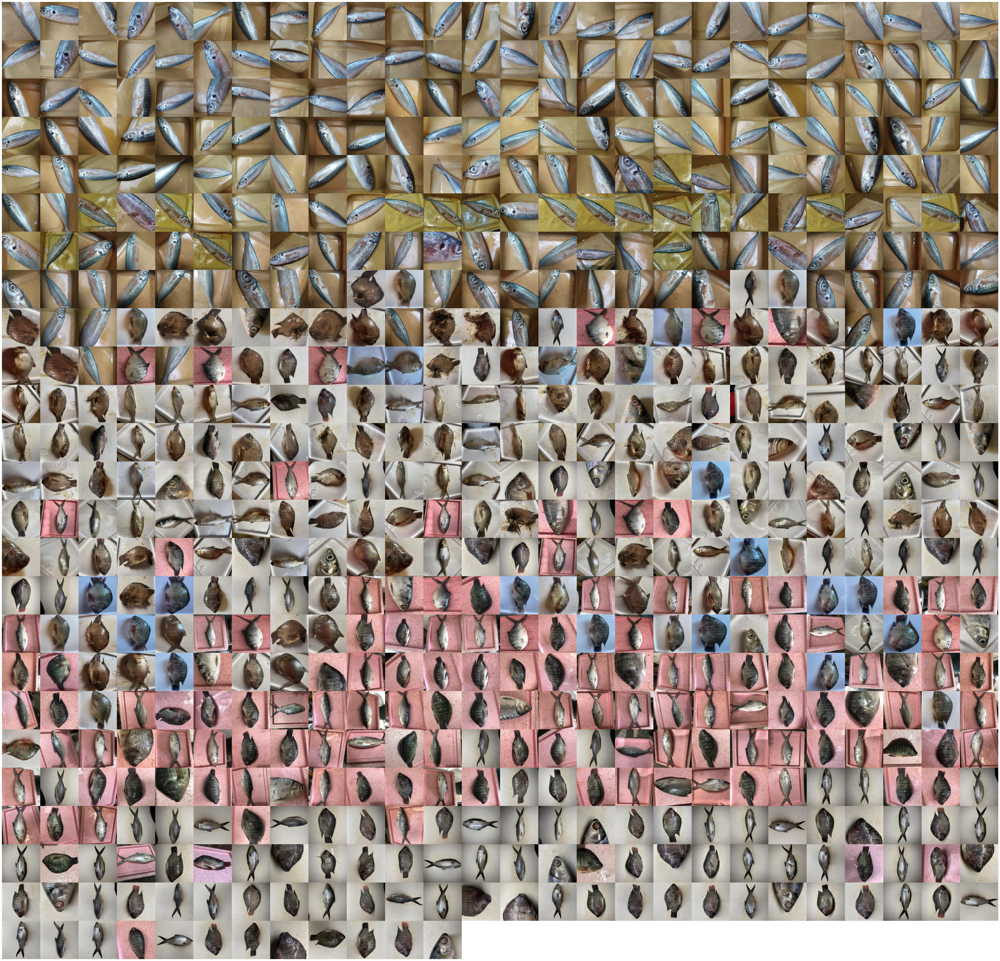

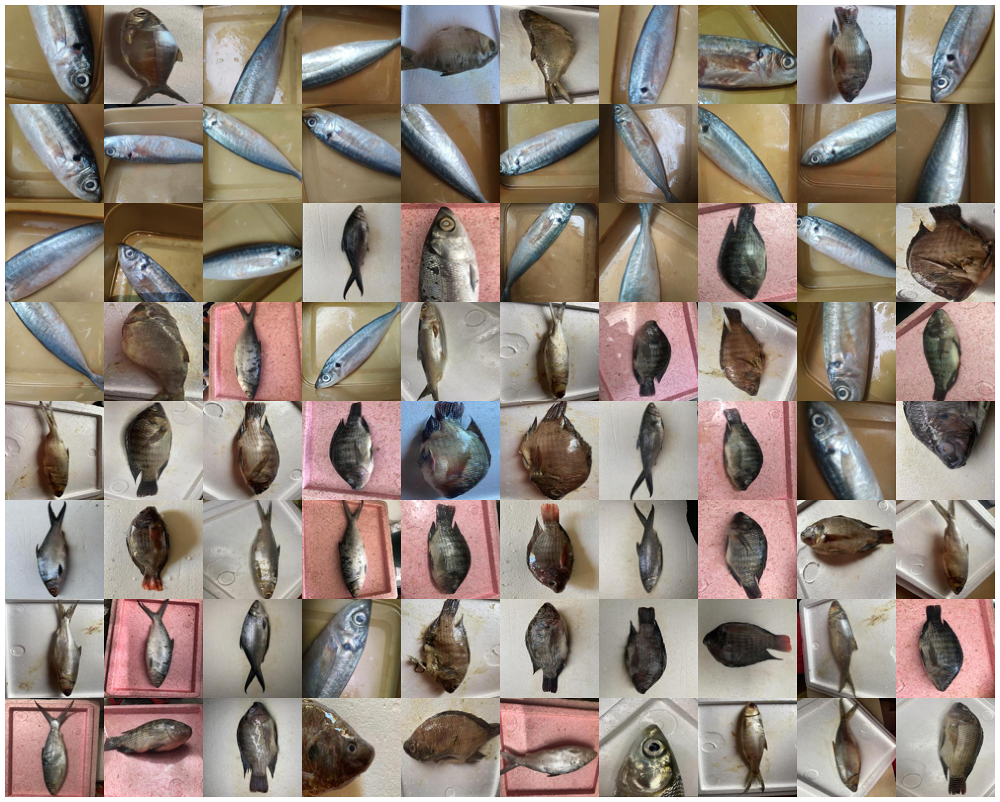

In [ ]:
import os
import hashlib
from PIL import Image, ImageOps

def hash_image(image_path):
    """Generate a hash for an image to detect duplicates."""
    with open(image_path, "rb") as f:
        img_hash = hashlib.md5(f.read()).hexdigest()
    return img_hash

def get_unique_filename(clean_dir, img_name, original_img_name):
    """Generate a unique filename if a file with the same name exists in the clean_dir."""
    base_name, ext = os.path.splitext(img_name)
    counter = 1
    new_name = img_name
    while os.path.exists(os.path.join(clean_dir, new_name)):
        new_name = f"{base_name}_{counter}{ext}"
        counter += 1

    # Notify the user when renaming occurs due to same filename but different hash
    if new_name != original_img_name:
        print(f"Renaming image '{original_img_name}' to '{new_name}' due to the same filename but different content.")

    return new_name

def clear_directory(directory):
    """Remove all files from the specified directory."""
    for filename in os.listdir(directory):
        file_path = os.path.join(directory, filename)
        if os.path.isfile(file_path):
            os.remove(file_path)

def clean_data(image_dir, clean_dir, allowed_formats=('jpeg', 'png', 'jpg'), target_size=(224, 224), resize_size=(256, 256)):
    """
    Clean image dataset by performing the following:
    1. Removing invalid or corrupted files.
    2. Removing unsupported image formats.
    3. Checking for duplicate images.
    4. Resizing images to a larger size and then cropping or padding to the target size.
    5. Saving cleaned images to a new folder with unique file names.
    """
    if not os.path.exists(clean_dir):
        os.makedirs(clean_dir)
    else:
        # Clear existing files in the clean_dir
        clear_directory(clean_dir)

    unique_hashes = set()  # To track unique images
    duplicate_count = 0
    invalid_images = 0
    unsupported_formats = 0

    for img_name in os.listdir(image_dir):
        img_path = os.path.join(image_dir, img_name)
        try:
            # Open the image to check if it's valid
            with Image.open(img_path) as img:
                img.verify()  # Check if the image is valid (not corrupted)
                img = Image.open(img_path)  # Reopen for further checks after verification

                # Check if the image format is allowed
                if img.format.lower() not in allowed_formats:
                    print(f"Skipping {img_name}: Unsupported format")
                    unsupported_formats += 1
                    continue

                # Resize image to a larger size (e.g., 256x256) while preserving aspect ratio
                img = ImageOps.fit(img, resize_size, method=Image.LANCZOS)  # Resize to 256x256

                # Crop or pad the image to the target size (224x224)
                img = ImageOps.fit(img, target_size, method=Image.LANCZOS, centering=(0.5, 0.5))

                # Generate a hash to identify duplicates
                img_hash = hash_image(img_path)
                if img_hash in unique_hashes:
                    print(f"Skipping {img_name}: Duplicate image")
                    duplicate_count += 1
                    continue

                unique_hashes.add(img_hash)

                # Generate a unique filename to avoid overwriting
                unique_img_name = get_unique_filename(clean_dir, img_name, img_name)

                # Save resized and padded image to the clean_dir
                img.save(os.path.join(clean_dir, unique_img_name))

        except (IOError, SyntaxError) as e:
            print(f"Skipping {img_name}: Error loading image")
            invalid_images += 1

    print(f"Data Cleaning Summary: \n - Duplicates: {duplicate_count} \n - Invalid Images: {invalid_images} \n"
          f" - Unsupported Formats: {unsupported_formats}")

def show_images_in_grid(image_dir, title, grid_size=(5, 5), image_size=(224, 224)):
    """
    Display images in a compact grid from the specified directory.

    :param image_dir: Directory containing images to display.
    :param title: Title for the grid (Train or Validation).
    :param grid_size: Tuple indicating the number of rows and columns in the grid.
    :param image_size: Size of each image to display (used to resize before display).
    """
    image_paths = [os.path.join(image_dir, img_name) for img_name in os.listdir(image_dir) if img_name.endswith(('jpeg', 'jpg', 'png'))]

    # Calculate the total number of images and grid dimensions
    total_images = len(image_paths)
    rows, cols = grid_size

    # Adjust the grid size if fewer images are available than grid spaces
    rows = min(rows, math.ceil(total_images / cols))

    fig, axes = plt.subplots(rows, cols, figsize=(cols * 2, rows * 2))

    # Iterate over the images and display them
    for i, ax in enumerate(axes.flat):
        if i < total_images:
            img_path = image_paths[i]
            img = Image.open(img_path)
            img = img.resize(image_size)  # Resize for display
            ax.imshow(img)
        ax.axis('off')  # Hide axes

    plt.subplots_adjust(wspace=0, hspace=0)  # Remove space between images
    plt.tight_layout(pad=0)  # Remove padding
    plt.show()

cleaned_train_images = clean_data(TRAIN_IMAGES_PATH, CLEANED_TRAIN_IMAGES_PATH, target_size=(224, 224), resize_size=(256, 256))
cleaned_valid_images = clean_data(VALID_IMAGES_PATH, CLEANED_VALID_IMAGES_PATH, target_size=(224, 224), resize_size=(256, 256))

# Display images in grid
show_images_in_grid(CLEANED_TRAIN_IMAGES_PATH, title="Cleaned Training Images", grid_size=(26, 26), image_size=(100, 100))
show_images_in_grid(CLEANED_VALID_IMAGES_PATH, title="Cleaned Validation Images", grid_size=(10, 10), image_size=(100, 100))


### Data Augmentations & Normalization

Train:
Original Image Count: 636
Total Augmented Count: 10176
Total Added via Augmentation: 9540

Valid:
Original Image Count: 80
Total Augmented Count: 1280
Total Added via Augmentation: 1200



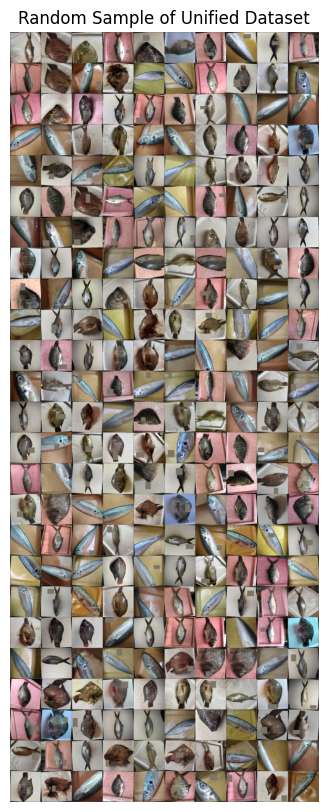

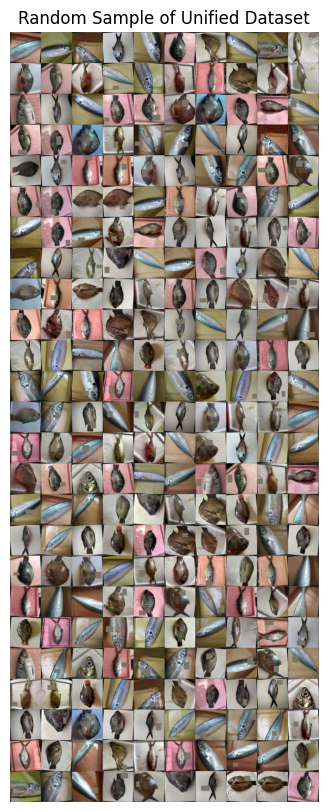

In [ ]:
import os
import random
import torch
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
from torchvision.utils import make_grid
from PIL import Image

# Load augmentation parameters (assumes you have this function defined)
TRAINING_PARAMS_YAML = os.path.join(CONFIG_PATH, 'training_params.yaml')
augment_params = load_yaml_config(TRAINING_PARAMS_YAML)

# Extract augmentation parameters
augmentation_config = augment_params['augmentations']
resize_scale = augmentation_config['resize_scale']
horizontal_flip_prob = augmentation_config['horizontal_flip']
vertical_flip_prob = augmentation_config['vertical_flip']
rotation_degrees = augmentation_config['rotation_degrees']
brightness = augmentation_config['brightness']
contrast = augmentation_config['contrast']
saturation = augmentation_config['saturation']
hue = augmentation_config['hue']
gaussian_blur_kernel = augmentation_config['gaussian_blur_kernel']
gamma_range = augmentation_config['gamma_range']
erasing_scale = augmentation_config['erasing_scale']
erase_ratio = augmentation_config['erase_ratio']

# Data transformation/augmentation pipeline setup
data_transforms = transforms.Compose([
    transforms.RandomResizedCrop(224, scale=(resize_scale[0], resize_scale[1])),
    transforms.RandomHorizontalFlip(p=horizontal_flip_prob),
    transforms.RandomVerticalFlip(p=vertical_flip_prob),
    transforms.RandomRotation(degrees=rotation_degrees),
    transforms.ColorJitter(brightness=brightness, contrast=contrast,
                           saturation=saturation, hue=hue),
    transforms.GaussianBlur(kernel_size=random.choice(gaussian_blur_kernel)),
    transforms.RandomAdjustSharpness(random.uniform(gamma_range[0], gamma_range[1]), p=0.5),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
    transforms.RandomErasing(scale=(erasing_scale[0], erasing_scale[1]),
                             ratio=(erase_ratio[0], erase_ratio[1]), p=0.5)
])

# Cache for augmented images
augmented_cache = {}

def generate_augmented_images(image_paths, transform, augmentations_per_image=5):
    for img_path in image_paths:
        # Open the original image
        img = Image.open(img_path).convert('RGB')

        # Generate augmented images and store in cache
        if img_path not in augmented_cache:
            augmented_cache[img_path] = []
            for aug_idx in range(augmentations_per_image):
                augmented_image = transform(img)  # Transform the original image
                augmented_cache[img_path].append(augmented_image)  # Store in cache

# Function to print a comparison of original and augmented image counts
def print_image_comparison(original_count, augmented_count, dataset_type):
    added_count = augmented_count - original_count
    print(f"{dataset_type}:")
    print(f"Original Image Count: {original_count}")
    print(f"Total Augmented Count: {augmented_count}")
    print(f"Total Added via Augmentation: {added_count}\n")

def show_random_sample(images, n_images=250):
    """Display a random sample of images from the unified dataset."""
    images_to_show = random.sample(images, min(n_images, len(images)))  # Randomly select up to n_images
    grid = make_grid(images_to_show, nrow=10, padding=2)  # 10 images per row

    # Unnormalize the images for display
    mean = torch.tensor([0.485, 0.456, 0.406]).view(3, 1, 1)
    std = torch.tensor([0.229, 0.224, 0.225]).view(3, 1, 1)
    grid = grid * std + mean  # Denormalize

    # Convert tensor to numpy for plotting
    grid = grid.permute(1, 2, 0).numpy()

    # Plot the grid
    plt.figure(figsize=(10, 10))  # Adjust the figure size as needed
    plt.imshow(grid)
    plt.axis('off')  # Hide the axes
    plt.title("Random Sample of Unified Dataset")
    plt.show()

# Example usage:
train_data = [os.path.join(CLEANED_TRAIN_IMAGES_PATH, f) for f in os.listdir(CLEANED_TRAIN_IMAGES_PATH)]
valid_data = [os.path.join(CLEANED_VALID_IMAGES_PATH, f) for f in os.listdir(CLEANED_VALID_IMAGES_PATH)]

# Generate augmented images and cache them
generate_augmented_images(train_data, data_transforms, augmentations_per_image=10)
generate_augmented_images(valid_data, data_transforms, augmentations_per_image=10)

# Count images
total_unaugmented_train_imgs = len(train_data)
total_unaugmented_valid_imgs = len(valid_data)

# Total augmented images based on augmentations per image
total_augmented_train_imgs = total_unaugmented_train_imgs * 16  # 16 augmentations per image
total_augmented_valid_imgs = total_unaugmented_valid_imgs * 16  # 16 augmentations per image

# Print comparison results
print_image_comparison(total_unaugmented_train_imgs, total_augmented_train_imgs, "Train")
print_image_comparison(total_unaugmented_valid_imgs, total_augmented_valid_imgs, "Valid")

# Show random samples of unified datasets
augmented_train_images = [augmented_cache[path] for path in train_data]
augmented_valid_images = [augmented_cache[path] for path in valid_data]

show_random_sample([img for imgs in augmented_train_images for img in imgs], n_images=250)  # Adjust n_images as needed
show_random_sample([img for imgs in augmented_valid_images for img in imgs], n_images=250)  # Adjust n_images as needed


## Training Phase

### Model Training

In [ ]:
import os
import random
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision.datasets as datasets
from torch.utils.data import DataLoader
from torchvision import models
from tqdm import tqdm
import yaml

# Iteration version counter
ITERATION_VER = "1p"

# Load configuration
TRAINING_PARAMS_YAML = os.path.join(CONFIG_PATH, 'training_params.yaml')
training_params = load_yaml_config(TRAINING_PARAMS_YAML)

# Training parameters
num_epochs = training_params['training']['num_epochs']
batch_size = training_params['training']['batch_size']
learning_rate = training_params['training']['learning_rate']

# Load the datasets
train_dataset = datasets.ImageFolder(root=unified_train_dataset)
valid_dataset = datasets.ImageFolder(root=unified_valid_dataset)

# Create DataLoaders
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2)
valid_loader = DataLoader(valid_dataset, batch_size=batch_size, shuffle=False, num_workers=2)

# Check for GPU
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Update the final fully connected layer to match the number of classes
resnet18.fc = nn.Linear(resnet18.fc.in_features, num_classes)
resnet18 = resnet18.to(device)

# Define loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(resnet18.parameters(), lr=learning_rate, weight_decay=1e-4)

# Define learning rate scheduler
scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)

# Early stopping criteria
best_valid_loss = float('inf')
patience = training_params['training'].get('patience', 5)  # Set patience for early stopping
early_stop_counter = 0

# Training and validation loop
for epoch in range(num_epochs):
    print(f'Epoch [{epoch+1}/{num_epochs}]')

    # Training phase
    resnet18.train()
    train_loss = 0
    train_correct = 0
    total_train = 0

    for images, labels in tqdm(train_loader):
        images, labels = images.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = resnet18(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        # Update metrics
        train_loss += loss.item()
        _, predicted = torch.max(outputs, 1)
        train_correct += (predicted == labels).sum().item()
        total_train += labels.size(0)

    train_loss /= len(train_loader)
    train_accuracy = 100 * train_correct / total_train

    # Validation phase
    resnet18.eval()
    valid_loss = 0
    valid_correct = 0
    total_valid = 0

    with torch.no_grad():
        for images, labels in tqdm(valid_loader):
            images, labels = images.to(device), labels.to(device)

            outputs = resnet18(images)
            loss = criterion(outputs, labels)

            valid_loss += loss.item()
            _, predicted = torch.max(outputs, 1)
            valid_correct += (predicted == labels).sum().item()
            total_valid += labels.size(0)

    valid_loss /= len(valid_loader)
    valid_accuracy = 100 * valid_correct / total_valid

    print(f'Train Loss: {train_loss:.4f}, Train Accuracy: {train_accuracy:.2f}%')
    print(f'Valid Loss: {valid_loss:.4f}, Valid Accuracy: {valid_accuracy:.2f}%')

    # Check if the validation loss improved
    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
        early_stop_counter = 0
        checkpoint_counter = 0
        checkpoint_counter++;
        checkpoint_name = ""

        # Save the best model
        torch.save(resnet18.state_dict(os.path.join(CHECKPOINT_PATH, ITERATION_VER)))
        printf("Model saved!")

    else:
        early_stop_counter += 1

    # Early stopping
    if early_stop_counter >= patience:
        print("Early stopping triggered!")
        break

    # Step the learning rate scheduler
    scheduler.step()



### Model Validation

## Load Trained Model's Architecture

In [ ]:
state_dict = torch.load('./runs/detect/HOOKitModel-pre-v0.3/weights/best.pt')

for key, value in state_dict.items():
    if isinstance(value, torch.Tensor):
        print(f"{key}: Tensor with shape {value.shape}")
    else:
        print(f"{key}: {type(value)} with value {value}")

## Testing Phase

_this section tests the TRAINED MODEL against UNSEEN DATA both static and realtime_

### Insert an Image Approach Inference OR Folder of Images

In [ ]:
import tkinter as tk
from tkinter import filedialog, messagebox, ttk
from ultralytics import YOLO
from PIL import Image, ImageTk
import numpy as np
import cv2
import os
import math
import sys


def create_image_grid(image_folder, grid_size=(5, 5)):
    """Create a grid of images from the output folder."""
    images = [img for img in os.listdir(
        image_folder) if img.startswith("output_")]
    if not images:
        print("No output images found.")
        return None

    n = min(len(images), grid_size[0] * grid_size[1])
    rows = min(grid_size[0], math.ceil(math.sqrt(n)))
    cols = min(grid_size[1], math.ceil(n / rows))

    with Image.open(os.path.join(image_folder, images[0])) as img:
        w, h = img.size

    grid_img = Image.new('RGB', (cols * w, rows * h), color='white')

    for i, image in enumerate(images[:n]):
        with Image.open(os.path.join(image_folder, image)) as img:
            grid_img.paste(img, ((i % cols) * w, (i // cols) * h))

    return grid_img


def load_model(model_path):
    """Load the YOLOv8 model."""
    try:
        return YOLO(model_path)
    except Exception as e:
        print(f"Error loading model: {e}")
        sys.exit(1)


def perform_inference(model, image_path):
    """Perform inference on the given image."""
    try:
        results = model(image_path)
        return results[0]
    except Exception as e:
        print(f"Error during inference: {e}")
        return None


def visualize_results(image_path, results):
    """Visualize the results on the image."""
    try:
        img = cv2.imread(image_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        result_plot = results.plot()
        return Image.fromarray(result_plot)
    except Exception as e:
        print(f"Error visualizing results: {e}")
        return None


def process_detections(results):
    """Process and return detection data."""
    detections = []
    for box in results.boxes:
        detections.append({
            'box': box.xyxy[0].tolist(),
            'confidence': float(box.conf[0]),
            'class': int(box.cls[0])
        })
    return detections


def safe_save(image, output_path):
    """Save the image with a unique filename to avoid overwriting."""
    base, ext = os.path.splitext(output_path)
    counter = 1
    while os.path.exists(output_path):
        output_path = f"{base}_{counter}{ext}"
        counter += 1
    image.save(output_path)
    return output_path


def process_image(model, image_path, output_folder):
    """Process a single image."""
    results = perform_inference(model, image_path)
    if results is None:
        return

    result_image = visualize_results(image_path, results)
    if result_image is None:
        return

    filename = os.path.basename(image_path)
    output_path = os.path.join(output_folder, f"output_{filename}")
    saved_path = safe_save(result_image, output_path)
    print(f"Result image saved as '{saved_path}'")

    detections = process_detections(results)
    print(f"Detections for {filename}:")
    for detection in detections:
        print(f"Box: {detection['box']}")
        print(f"Confidence: {detection['confidence']}")
        print(f"Class: {detection['class']}")
        print("---")
    print("\n")


def process_folder(model, folder_path, output_folder):
    """Process all images in the specified folder."""
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    for filename in os.listdir(folder_path):
        if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.tiff', '.bmp', '.gif')):
            image_path = os.path.join(folder_path, filename)
            process_image(model, image_path, output_folder)


def get_next_grid_number():
    i = 1
    while os.path.exists(f"image_grid_output_{i}.jpg"):
        i += 1
    return i


class YOLOApp:
    def __init__(self, master):
        self.master = master
        master.title("HOOKit pre-release v0.3")
        master.geometry("500x700")

        self.model = None
        self.current_image = None
        self.output_folder = None

        # Create main frame
        main_frame = ttk.Frame(master, padding="10")
        main_frame.grid(row=0, column=0, sticky=(tk.W, tk.E, tk.N, tk.S))
        master.columnconfigure(0, weight=1)
        master.rowconfigure(0, weight=1)

        # Model container
        model_frame = ttk.LabelFrame(
            main_frame, text="Model Selection", padding="10")
        model_frame.grid(row=0, column=0, columnspan=2,
                         sticky=(tk.W, tk.E), pady=5)
        model_frame.columnconfigure(1, weight=1)

        self.model_button = ttk.Button(
            model_frame, text="Load Model", command=self.load_model)
        self.model_button.grid(row=0, column=0, sticky=tk.W)

        self.current_model_label = ttk.Label(
            model_frame, text="Current Model: None")
        self.current_model_label.grid(
            row=0, column=1, sticky=tk.W, padx=(10, 0))

        # Image selection container
        image_frame = ttk.LabelFrame(
            main_frame, text="Image Selection", padding="10")
        image_frame.grid(row=1, column=0, sticky=(tk.W, tk.E), pady=5)
        image_frame.columnconfigure(1, weight=1)

        self.image_button = ttk.Button(
            image_frame, text="Choose Image", command=self.load_image)
        self.image_button.grid(row=0, column=0, sticky=tk.W)

        self.current_image_label = ttk.Label(
            image_frame, text="No image selected")
        self.current_image_label.grid(
            row=0, column=1, sticky=tk.W, padx=(10, 0))

        # Output folder container
        output_frame = ttk.LabelFrame(
            main_frame, text="Output Folder", padding="10")
        output_frame.grid(row=1, column=1, sticky=(tk.W, tk.E), pady=5)
        output_frame.columnconfigure(1, weight=1)

        self.output_button = ttk.Button(
            output_frame, text="Set Output Folder", command=self.set_output_folder)
        self.output_button.grid(row=0, column=0, sticky=tk.W)

        self.output_label = ttk.Label(output_frame, text="No folder selected")
        self.output_label.grid(row=0, column=1, sticky=tk.W, padx=(10, 0))

        # Infer container
        infer_frame = ttk.LabelFrame(
            main_frame, text="Inference", padding="10")
        infer_frame.grid(row=2, column=0, columnspan=2,
                         sticky=(tk.W, tk.E), pady=5)

        self.infer_button = ttk.Button(
            infer_frame, text="Infer Now", command=self.infer_now, state=tk.DISABLED)
        self.infer_button.pack()

        # Folder processing container
        folder_frame = ttk.LabelFrame(
            main_frame, text="Multiple Image Processing", padding="10")
        folder_frame.grid(row=3, column=0, columnspan=2,
                          sticky=(tk.W, tk.E), pady=5)

        self.folder_button = ttk.Button(
            folder_frame, text="Select a Folder", command=self.process_folder)
        self.folder_button.pack()

        # Real-time inference container
        realtime_frame = ttk.LabelFrame(
            main_frame, text="Real-time Inference", padding="10")
        realtime_frame.grid(row=4, column=0, columnspan=2,
                            sticky=(tk.W, tk.E), pady=5)

        self.realtime_button = ttk.Button(
            realtime_frame, text="Start Real-time Inference", command=self.toggle_realtime_inference)
        self.realtime_button.pack()

        self.camera_var = tk.StringVar()
        self.camera_dropdown = ttk.Combobox(
            realtime_frame, textvariable=self.camera_var)
        self.camera_dropdown.pack(pady=5)
        self.update_camera_list()

        # Add a label to display the webcam feed
        self.video_label = ttk.Label(main_frame)
        self.video_label.grid(row=5, column=0, columnspan=2, pady=5)

        # Initialize webcam variables
        self.cap = None
        self.is_realtime_active = False

    def load_model(self):
        model_path = filedialog.askopenfilename(
            filetypes=[("YOLO Model", "*.pt")])
        if model_path:
            try:
                self.model = load_model(model_path)
                model_name = os.path.basename(model_path)
                self.current_model_label.config(
                    text=f"Current Model: {model_name}")
                messagebox.showinfo("Success", "Model loaded successfully!")
            except Exception as e:
                messagebox.showerror(
                    "Error", f"Failed to load model: {str(e)}")

    def load_image(self):
        image_path = filedialog.askopenfilename(
            filetypes=[("Image files", "*.png *.jpg *.jpeg *.tiff *.bmp *.gif")])
        if image_path:
            self.current_image = image_path
            self.current_image_label.config(text=os.path.basename(image_path))
            self.infer_button.config(state=tk.NORMAL)
            messagebox.showinfo("Success", "Image loaded successfully!")

    def set_output_folder(self):
        self.output_folder = filedialog.askdirectory()
        if self.output_folder:
            self.output_label.config(text=os.path.basename(self.output_folder))
            messagebox.showinfo("Success", "Output folder set successfully!")

    def infer_now(self):
        if not self.model:
            messagebox.showerror("Error", "Please load a model first.")
            return
        if not self.output_folder:
            messagebox.showerror(
                "Error", "Please select an output folder first.")
            return
        if not self.current_image:
            messagebox.showerror("Error", "Please load an image first.")
            return

        process_image(self.model, self.current_image, self.output_folder)
        messagebox.showinfo("Success", "Image processed successfully!")

    def process_folder(self):
        if not self.model:
            messagebox.showerror("Error", "Please load a model first.")
            return
        if not self.output_folder:
            messagebox.showerror(
                "Error", "Please select an output folder first.")
            return

        folder_path = filedialog.askdirectory()
        if folder_path:
            process_folder(self.model, folder_path, self.output_folder)
            grid_image = create_image_grid(
                self.output_folder, grid_size=(5, 5))
            if grid_image:
                grid_number = get_next_grid_number()
                grid_filename = f"image_grid_output_{grid_number}.jpg"
                grid_image.save(os.path.join(
                    self.output_folder, grid_filename))
                messagebox.showinfo(
                    "Success", f"Folder processed and grid image saved as '{grid_filename}'")
            else:
                messagebox.showinfo(
                    "Success", "Folder processed successfully!")

    def list_available_cameras(self):
        index = 0
        cameras = []
        while True:
            cap = cv2.VideoCapture(index)
            if not cap.read()[0]:
                break
            else:
                cameras.append(index)
            cap.release()
            index += 1
        return cameras

    def update_camera_list(self):
        cameras = self.list_available_cameras()
        self.camera_dropdown['values'] = [f"Camera {i}" for i in cameras]
        if cameras:
            self.camera_dropdown.set(f"Camera {cameras[0]}")

    def toggle_realtime_inference(self):
        if not self.model:
            messagebox.showerror("Error", "Please load a model first.")
            return

        if self.is_realtime_active:
            self.stop_realtime_inference()
        else:
            self.start_realtime_inference()

    def start_realtime_inference(self):
        camera_index = int(self.camera_var.get().split()[-1])
        self.cap = cv2.VideoCapture(camera_index)
        if not self.cap.isOpened():
            messagebox.showerror(
                "Error", f"Failed to open camera {camera_index}")
            return
        self.is_realtime_active = True
        self.realtime_button.config(text="Stop Real-time Inference")
        self.update_webcam()

    def stop_realtime_inference(self):
        if self.cap:
            self.cap.release()
        self.is_realtime_active = False
        self.realtime_button.config(text="Start Real-time Inference")
        self.video_label.config(image='')

    def update_webcam(self):
        if self.is_realtime_active:
            ret, frame = self.cap.read()
            if ret:
                results = self.model(frame)
                result_frame = results[0].plot()
                img = Image.fromarray(cv2.cvtColor(
                    result_frame, cv2.COLOR_BGR2RGB))
                img = ImageTk.PhotoImage(img)
                self.video_label.config(image=img)
                self.video_label.image = img
            self.master.after(10, self.update_webcam)

    def on_closing(self):
        if self.cap:
            self.cap.release()
        self.master.destroy()


def main():
    root = tk.Tk()
    app = YOLOApp(root)
    root.protocol("WM_DELETE_WINDOW", app.on_closing)
    root.mainloop()


if __name__ == "__main__":
    main()

In [ ]:
from PIL import Image, ImageTk

### Inference via Realtime Camera

In [ ]:
%pip install ultralytics opencv-python

from ultralytics import YOLO
import cv2

# Load the newly custom trained model
model = YOLO(MODEL_PATH)

# Open the laptop camera
cap = cv2.VideoCapture(1)

while True:
    # Read a frame from the camera
    ret, frame = cap.read()

    if not ret:
        break

    # Run inference on the frame
    results = model(frame)

    # Visualize the results on the frame
    annotated_frame = results[0].plot()

    # Display the annotated frame
    cv2.imshow("HOOKitModel-pre-v0.3", annotated_frame)

    # Break the loop if 'q' is pressed
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release the camera and close windows
cap.release()
cv2.destroyAllWindows()

## Pre-Deployment Phase

### Export the Base Model Summary into a .DOCX File

In [ ]:
# Parse the data
data = []
for line in """from n params module arguments
0 -1 1 464 ultralytics.nn.modules.conv.Conv [3, 16, 3, 2]
1 -1 1 4672 ultralytics.nn.modules.conv.Conv [16, 32, 3, 2]
2 -1 1 7360 ultralytics.nn.modules.block.C2f [32, 32, 1, True]
3 -1 1 18560 ultralytics.nn.modules.conv.Conv [32, 64, 3, 2]
4 -1 2 49664 ultralytics.nn.modules.block.C2f [64, 64, 2, True]
5 -1 1 73984 ultralytics.nn.modules.conv.Conv [64, 128, 3, 2]
6 -1 2 197632 ultralytics.nn.modules.block.C2f [128, 128, 2, True]
7 -1 1 295424 ultralytics.nn.modules.conv.Conv [128, 256, 3, 2]
8 -1 1 460288 ultralytics.nn.modules.block.C2f [256, 256, 1, True]
9 -1 1 164608 ultralytics.nn.modules.block.SPPF [256, 256, 5]
10 -1 1 0 torch.nn.modules.upsampling.Upsample [None, 2, 'nearest']
11 [-1, 6] 1 0 ultralytics.nn.modules.conv.Concat [1]
12 -1 1 148224 ultralytics.nn.modules.block.C2f [384, 128, 1]
13 -1 1 0 torch.nn.modules.upsampling.Upsample [None, 2, 'nearest']
14 [-1, 4] 1 0 ultralytics.nn.modules.conv.Concat [1]
15 -1 1 37248 ultralytics.nn.modules.block.C2f [192, 64, 1]
16 -1 1 36992 ultralytics.nn.modules.conv.Conv [64, 64, 3, 2]
17 [-1, 12] 1 0 ultralytics.nn.modules.conv.Concat [1]
18 -1 1 123648 ultralytics.nn.modules.block.C2f [192, 128, 1]
19 -1 1 147712 ultralytics.nn.modules.conv.Conv [128, 128, 3, 2]""".split('\n')[1:]:  # Skip the header
    parts = line.split()
    data.append({
        'n': parts[0],
        'from': parts[1],
        'params': parts[3],
        'module': parts[4],
        'arguments': ' '.join(parts[5:])
    })

# Create a pandas DataFrame
df = pd.DataFrame(data)

# Create a new Word document
doc = Document()

# Add a title
doc.add_heading('Model Summary', 0)

# Add the table
table = doc.add_table(rows=1, cols=5)
table.style = 'Table Grid'

# Add the header row
header_cells = table.rows[0].cells
header_cells[0].text = 'n'
header_cells[1].text = 'from'
header_cells[2].text = 'params'
header_cells[3].text = 'module'
header_cells[4].text = 'arguments'

# Add the data rows
for _, row in df.iterrows():
    cells = table.add_row().cells
    cells[0].text = row['n']
    cells[1].text = row['from']
    cells[2].text = row['params']
    cells[3].text = row['module']
    cells[4].text = row['arguments']

# Add the summary
doc.add_paragraph(
    '\nModel summary: 225 layers, 3014748 parameters, 3014732 gradients, 8.2 GFLOPs')

# Save the document
doc.save('model_summary.docx')

print("Document 'model_summary.docx' has been created.")

### Convert and Export Trained Model to ONNX

In [ ]:
import tensorflow.keras as tf_keras

# Select what format to be EXPORTED
print("Select the format you want to export to: \n\t 1. ONNX \n\t 2. TFLite \n\t 3. CoreML")

try:
    model_format = int(input())

    if model_format == 1:
        model_format = "onnx"
    elif model_format == 2:
        model_format = "tflite"
    elif model_format == 3:
        model_format = "coreml"
    else:
        raise ValueError
except ValueError:
    raise ValueError("Wrong format selected, please select 1 or 2 or 3 only.")

# Load your model

model = YOLO(MODEL_PATH)
print(f"Model was successfully loaded from {MODEL_PATH}!")
print(f"We're now EXPORTING your model to {model_format.upper()} format!")


# Export the model to whatever chosen
model.export(format=model_format)

print(f"Model was successfully exported to {format}!")

### Validate the ONNX Model's Formation

In [ ]:
# Load the ONNX model
onnx_model = onnx.load(ONNX_PATH)

# Check that the model if it is well formed
onnx.checker.check_model(onnx_model)

print("Model was successfully converted to ONNX and is well-formed!")

## Utilities

### AquaGrade's Smart Nitpicker of Dataspecimen

In [ ]:
import os
import shutil
import random
from tkinter import Tk, filedialog, messagebox, Label
from PIL import Image, ImageTk

COPIED_IMAGES_FILE = "copied_images.txt"


def select_folder(root):
    while True:
        folder_path = filedialog.askdirectory(
            title="Select folder containing images")
        if folder_path:
            return folder_path
        else:
            if messagebox.askokcancel("Exit", "No folder selected. Do you want to exit?"):
                root.quit()
                return None


def create_new_folder(parent_path):
    while True:
        new_folder_name = input(
            "Enter a name for the destination folder (default: Copied_Images): ").strip()
        if not new_folder_name:
            new_folder_name = "Copied_Images"
        new_folder_path = os.path.join(parent_path, new_folder_name)
        try:
            os.makedirs(new_folder_path, exist_ok=True)
            return new_folder_path
        except PermissionError:
            print("Permission denied. Please choose a different name.")
        except OSError as e:
            print(f"Error creating folder: {e}")


def get_file_types():
    print("Select file types to copy (separate with commas):")
    print("1. PNG")
    print("2. JPG/JPEG")
    print("3. GIF")
    print("4. BMP")
    print("5. All of the above")
    choice = input("Enter your choices (e.g., 1,2,3): ")
    types = {
        '1': '.png', '2': ('.jpg', '.jpeg'), '3': '.gif', '4': '.bmp',
        '5': ('.png', '.jpg', '.jpeg', '.gif', '.bmp')
    }
    selected = set()
    for c in choice.split(','):
        selected.update(types.get(c.strip(), ()))
    return selected


def load_copied_images():
    if os.path.exists(COPIED_IMAGES_FILE):
        with open(COPIED_IMAGES_FILE, "r") as f:
            return set(line.strip() for line in f)
    return set()


def save_copied_image(image_name):
    with open(COPIED_IMAGES_FILE, "a") as f:
        f.write(f"{image_name}\n")


def copy_random_images(source_folder, destination_folder, num_images, file_types):
    copied_images_set = load_copied_images()
    image_files = [f for f in os.listdir(source_folder)
                   if os.path.splitext(f.lower())[1] in file_types and f not in copied_images_set]

    if not image_files:
        print("No matching image files found in the selected folder.")
        return []

    num_to_copy = min(num_images, len(image_files))
    selected_images = random.sample(image_files, num_to_copy)

    copied_images = []
    for image in selected_images:
        source_path = os.path.join(source_folder, image)
        destination_path = os.path.join(destination_folder, image)
        try:
            shutil.copy2(source_path, destination_path)
            copied_images.append(destination_path)
            save_copied_image(image)
            print(f"Copied '{image}' to '{destination_folder}'")
        except (PermissionError, OSError) as e:
            print(f"Error copying '{image}': {e}")

    print(f"Copied {len(copied_images)} out of {
          num_to_copy} requested images to '{destination_folder}'")
    return copied_images


def get_number_of_images():
    while True:
        try:
            num = int(input("How many images would you like to copy? "))
            if num > 0:
                return num
            else:
                print("Please enter a positive number.")
        except ValueError:
            print("Please enter a valid number.")


def preview_images(root, image_paths):
    root.deiconify()  # Make sure the window is visible
    root.title("Image Preview")

    for i, path in enumerate(image_paths):
        try:
            img = Image.open(path)
            img.thumbnail((100, 100))
            photo = ImageTk.PhotoImage(img)
            label = Label(root, image=photo)
            label.image = photo
            label.grid(row=i//5, column=i % 5, padx=5, pady=5)
        except Exception as e:
            print(f"Error previewing image {path}: {e}")


def on_closing():
    if os.path.exists(COPIED_IMAGES_FILE):
        os.remove(COPIED_IMAGES_FILE)
    root.destroy()


def main():
    global root
    root = Tk()

    while True:
        source_folder = select_folder(root)
        if not source_folder:
            print("Exiting the program.")
            return

        num_images = get_number_of_images()
        file_types = get_file_types()

        parent_folder = os.path.dirname(source_folder)
        new_folder = create_new_folder(parent_folder)

        copied_images = copy_random_images(
            source_folder, new_folder, num_images, file_types)

        if copied_images:
            preview_images(root, copied_images)

        if messagebox.askyesno("Repeat", "Do you want to select another folder and copy more images?"):
            continue
        else:
            break

    root.protocol("WM_DELETE_WINDOW", on_closing)
    root.mainloop()


if __name__ == "__main__":
    main()

### AquaGrade's Folder Image Division

In [ ]:
import os
import shutil
import math
import tkinter as tk
from tkinter import filedialog, messagebox


def divide_images():
    source_folder = source_entry.get()
    destination_folder = dest_entry.get()

    try:
        num_divisions = int(divisions_entry.get())
    except ValueError:
        messagebox.showerror(
            "Error", "Number of divisions must be an integer.")
        return

    if not source_folder or not destination_folder or num_divisions <= 0:
        messagebox.showerror("Error", "Please fill in all fields correctly.")
        return

    if not os.path.exists(source_folder):
        messagebox.showerror("Error", "Source folder does not exist.")
        return

    # Create the destination folder if it doesn't exist
    if not os.path.exists(destination_folder):
        os.makedirs(destination_folder)

    # Get all image files from the source folder
    image_files = [f for f in os.listdir(source_folder) if f.lower().endswith(
        ('.png', '.jpg', '.jpeg', '.gif', '.bmp'))]

    # Remove duplicates (if any) based on filenames
    image_files = list(dict.fromkeys(image_files))

    if not image_files:
        messagebox.showerror(
            "Error", "No image files found in the source folder.")
        return

    # Calculate the number of images per division
    images_per_division = math.ceil(len(image_files) / num_divisions)

    # Keep track of copied images
    copied_images = set()

    # Divide and copy the images
    for i in range(num_divisions):
        # Create a new subfolder for each division
        subfolder_name = f"batch_{i+1}"
        subfolder_path = os.path.join(destination_folder, subfolder_name)
        os.makedirs(subfolder_path, exist_ok=True)

        # Calculate the range of images for this division
        start_index = i * images_per_division
        end_index = min((i + 1) * images_per_division, len(image_files))

        # Copy the images to the subfolder
        for image_file in image_files[start_index:end_index]:
            if image_file not in copied_images:
                source_path = os.path.join(source_folder, image_file)
                destination_path = os.path.join(subfolder_path, image_file)
                shutil.copy2(source_path, destination_path)
                copied_images.add(image_file)

    messagebox.showinfo("Success", f"Images divided into {num_divisions} folders successfully.\n"
                        f"{len(copied_images)} unique images copied.\n"
                        f"Original folder '{source_folder}' remains unchanged.")


def browse_source():
    folder_selected = filedialog.askdirectory()
    source_entry.delete(0, tk.END)
    source_entry.insert(0, folder_selected)


def browse_dest():
    folder_selected = filedialog.askdirectory()
    dest_entry.delete(0, tk.END)
    dest_entry.insert(0, folder_selected)


# Create the main window
root = tk.Tk()
root.title("Image Folder Divider")
root.geometry("400x200")

# Source folder
tk.Label(root, text="Source Folder:").grid(
    row=0, column=0, sticky="e", padx=5, pady=5)
source_entry = tk.Entry(root, width=30)
source_entry.grid(row=0, column=1, padx=5, pady=5)
tk.Button(root, text="Browse", command=browse_source).grid(
    row=0, column=2, padx=5, pady=5)

# Destination folder
tk.Label(root, text="Destination Folder:").grid(
    row=1, column=0, sticky="e", padx=5, pady=5)
dest_entry = tk.Entry(root, width=30)
dest_entry.grid(row=1, column=1, padx=5, pady=5)
tk.Button(root, text="Browse", command=browse_dest).grid(
    row=1, column=2, padx=5, pady=5)

# Number of divisions
tk.Label(root, text="Number of Divisions:").grid(
    row=2, column=0, sticky="e", padx=5, pady=5)
divisions_entry = tk.Entry(root, width=30)
divisions_entry.grid(row=2, column=1, padx=5, pady=5)

# Divide button
tk.Button(root, text="Divide Images", command=divide_images).grid(
    row=3, column=1, pady=20)

root.mainloop()

### AquaGrade's JSON Combiner

In [ ]:
import json

# Paths to your eight JSON files
json_paths = [
    "json_files/batch_1_result.json", "json_files/batch_2_result.json",
    "json_files/batch_3_result.json", "json_files/batch_4_result.json",
    "json_files/batch_5_result.json", "json_files/batch_6_result.json",
    "json_files/batch_7_result.json", "json_files/batch_8_result.json"
]

merged_data = {
    "images": [],
    "annotations": [],
    "categories": []  # assume categories are the same in all files
}

# Initialize counters for IDs
image_id_counter = 0
annotation_id_counter = 0
new_category_mapping = {}
new_category_id = 0

for path in json_paths:
    with open(path, 'r') as file:
        data = json.load(file)

        # Filter categories and create new ID mapping
        if not merged_data["categories"]:
            for category in data["categories"]:
                if "GILL-COLOR" not in category["name"]:
                    category["id"] = new_category_id
                    new_category_mapping[category["id"]] = new_category_id
                    merged_data["categories"].append(category)
                    new_category_id += 1

        # Merge images and annotations, updating IDs
        for image in data["images"]:
            image["id"] = image_id_counter
            merged_data["images"].append(image)
            image_id_counter += 1

        for annotation in data["annotations"]:
            # Only include annotations with categories that were not filtered out
            if annotation["category_id"] in new_category_mapping:
                annotation["id"] = annotation_id_counter
                # Update category_id using the new mapping
                annotation["category_id"] = new_category_mapping[annotation["category_id"]]
                annotation["image_id"] = image_id_counter - \
                    len(data["images"])  # Adjust image_id offset
                merged_data["annotations"].append(annotation)
                annotation_id_counter += 1

# Save the merged JSON
with open("merged_result.json", 'w') as outfile:
    json.dump(merged_data, outfile)
